In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import shutil
import cv2
import os
from tqdm import tqdm
import random

random.seed(42)

In [2]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.87 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6170.1/8062.4 GB disk)


In [3]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolo11l.yaml")

# Train the model
results = model.train(data="/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml", 
                      epochs=100,
                      patience=10,
                      imgsz=640,
                      pretrained=False,
                      device=0,
                      # batch=32,
                      # optimizer='AdamW',
                      # lr0=0.001,
                      # momentum=0.9,
                      )

Ultralytics 8.3.87 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11l.yaml, data=/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml, epochs=100, time=None, patience=10, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=T

100%|██████████| 755k/755k [00:00<00:00, 16.4MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  2    173824  ultralytics.nn.modules.block.C3k2            [128, 256, 2, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  2    691712  ultralytics.nn.modules.block.C3k2            [256, 512, 2, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  2   2234368  ultralytics.nn.modules.block.C3k2            [512, 512, 2, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 74.8MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/train/labels... 1740 images, 442 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:04<00:00, 353.40it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/val/labels... 217 images, 55 backgrounds, 0 corrupt: 100%|██████████| 217/217 [00:00<00:00, 359.63it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/val is not writeable, cache not saved.


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      10.3G      3.394      5.531      3.784         14        640: 100%|██████████| 109/109 [01:19<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.28it/s]

                   all        217        163      0.669     0.0303    0.00648    0.00323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      12.4G      2.735      3.692      2.969         12        640: 100%|██████████| 109/109 [01:25<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.526      0.241      0.176     0.0565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      12.5G      2.513      3.014       2.66         12        640: 100%|██████████| 109/109 [01:23<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.64it/s]

                   all        217        163      0.609      0.223      0.209     0.0854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      12.5G      2.366      2.722      2.551          8        640: 100%|██████████| 109/109 [01:23<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.172       0.14     0.0683      0.024



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      12.5G      2.206      2.368      2.409         22        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.418      0.458      0.379      0.173



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      12.5G       2.17      2.245      2.383         20        640: 100%|██████████| 109/109 [01:23<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.215      0.186       0.16     0.0591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      12.5G      2.103      2.168      2.313         16        640: 100%|██████████| 109/109 [01:23<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.64it/s]

                   all        217        163      0.481       0.44      0.454      0.185



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      12.5G      2.081      2.046      2.299         12        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.592      0.473      0.515      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      12.5G      2.011      1.953      2.261         16        640: 100%|██████████| 109/109 [01:22<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.661      0.571      0.606      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      12.5G      1.971      1.858      2.212         15        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.652      0.542      0.581      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      12.5G      1.975      1.887      2.216         18        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.608      0.609      0.646      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      12.5G      1.958      1.755      2.189         21        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.64it/s]

                   all        217        163      0.582      0.633      0.633      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      12.5G      1.933      1.771      2.174         10        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.664      0.611      0.654      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      12.5G      1.888      1.691      2.124         15        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.714      0.621      0.699      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      12.5G      1.879      1.666      2.109         20        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.716      0.551      0.638      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      12.5G      1.885      1.666      2.109         14        640: 100%|██████████| 109/109 [01:22<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.704      0.588      0.672      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      12.5G      1.855       1.57       2.09         14        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.758      0.516      0.569      0.302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      12.5G      1.872      1.618       2.11         12        640: 100%|██████████| 109/109 [01:22<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.64it/s]

                   all        217        163      0.664      0.651      0.699      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      12.5G       1.85      1.503      2.063         15        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.604      0.708      0.682      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      12.5G      1.864      1.507      2.088         11        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.708      0.408       0.46      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      12.5G      1.828       1.51      2.058         15        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.695      0.554      0.603      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      12.5G      1.789      1.461      2.012          7        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.677      0.619       0.63      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      12.5G      1.769      1.501      2.028         10        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.727      0.566       0.68      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      12.5G      1.785      1.447      2.027         15        640: 100%|██████████| 109/109 [01:23<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.64it/s]

                   all        217        163      0.742      0.552       0.64      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      12.5G        1.8      1.453      2.039         13        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.719      0.611      0.701      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      12.5G      1.751       1.41      2.022         12        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.792      0.624      0.724      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      12.5G      1.791      1.424      2.046         10        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.722       0.72      0.776      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      12.5G       1.74      1.351      1.966         16        640: 100%|██████████| 109/109 [01:22<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.707      0.621       0.67      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      12.5G      1.758      1.337      2.008         17        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.677      0.691      0.726      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      12.5G      1.747      1.354      1.974         11        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.759      0.701      0.779      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      12.5G       1.72      1.328      1.973         12        640: 100%|██████████| 109/109 [01:22<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.655      0.719      0.709      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      12.5G      1.741      1.352      1.976         14        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.765      0.654      0.747      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      12.5G      1.697      1.268      1.923         16        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.742      0.655      0.728      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      12.5G      1.717       1.26      1.969         14        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.788      0.675      0.763        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      12.5G      1.709      1.234      1.952         16        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.632      0.475      0.577      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      12.5G       1.72      1.237      1.982         16        640: 100%|██████████| 109/109 [01:22<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.779      0.706       0.76        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      12.5G      1.716      1.237      1.932         15        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.793      0.664       0.78      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      12.5G      1.702      1.247      1.965         21        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.777      0.666      0.754      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      12.5G      1.674      1.211      1.947          8        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.845      0.701      0.803      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      12.5G      1.675      1.187      1.908         16        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.804      0.723      0.799      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      12.5G      1.637      1.174      1.896          6        640: 100%|██████████| 109/109 [01:22<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163       0.76      0.693      0.784      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      12.5G      1.662      1.186      1.926         15        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.763      0.672      0.747      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      12.5G      1.631      1.167       1.89         16        640: 100%|██████████| 109/109 [01:22<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.716      0.766      0.778      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      12.5G      1.646      1.148      1.896         18        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.825      0.714      0.799      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      12.5G      1.632      1.157        1.9         14        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.877      0.667      0.806      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      12.5G       1.64      1.135      1.901         13        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.749      0.717      0.774      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      12.5G      1.645       1.13      1.918         17        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.772      0.758      0.795      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      12.5G      1.627      1.145      1.875         13        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.792      0.741      0.822      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      12.5G      1.612      1.111      1.853         11        640: 100%|██████████| 109/109 [01:22<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.704      0.666       0.72      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      12.5G      1.568      1.076       1.84         20        640: 100%|██████████| 109/109 [01:22<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163       0.84       0.72      0.826      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      12.5G      1.597      1.107      1.868         13        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163       0.79      0.707      0.797      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      12.5G      1.582      1.106      1.847         19        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.757      0.748      0.815      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      12.5G      1.599      1.064      1.841          9        640: 100%|██████████| 109/109 [01:22<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.842       0.63      0.762      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      12.5G      1.565      1.045      1.854         14        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.769      0.759      0.823      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      12.5G      1.555      1.031      1.821         21        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.793      0.775      0.853      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      12.5G      1.567      1.057      1.845         14        640: 100%|██████████| 109/109 [01:22<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.879      0.711      0.845       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      12.5G      1.555      1.018      1.828         15        640: 100%|██████████| 109/109 [01:22<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.68it/s]

                   all        217        163      0.835      0.711      0.838      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      12.5G      1.534      1.018      1.799         16        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163       0.84      0.747      0.853      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      12.5G       1.55      1.008      1.806         13        640: 100%|██████████| 109/109 [01:22<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        163      0.833      0.749      0.854      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      12.5G      1.539     0.9967      1.827         14        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.68it/s]

                   all        217        163      0.855      0.736      0.855      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      12.5G      1.538      1.015      1.817         12        640: 100%|██████████| 109/109 [01:22<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.857      0.705      0.837      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      12.5G      1.511     0.9803        1.8         24        640: 100%|██████████| 109/109 [01:22<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.843      0.732      0.848      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      12.5G      1.498     0.9884      1.782          8        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163       0.86      0.729      0.842      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      12.5G      1.531      1.003       1.81         13        640: 100%|██████████| 109/109 [01:22<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.906       0.77      0.891      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      12.5G      1.492     0.9586      1.783         18        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.68it/s]

                   all        217        163      0.869       0.74      0.866      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      12.5G       1.52     0.9723      1.809         13        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.753      0.791      0.837      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      12.5G      1.479     0.9769      1.791         12        640: 100%|██████████| 109/109 [01:22<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.832      0.773      0.854      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      12.5G      1.505      0.975      1.785         16        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.751      0.701      0.767      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      12.5G      1.491     0.9552       1.79          8        640: 100%|██████████| 109/109 [01:22<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.846      0.746      0.862      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      12.5G      1.464     0.9191      1.761         19        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.784      0.801      0.857      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      12.5G      1.483     0.9341       1.76         11        640: 100%|██████████| 109/109 [01:22<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.66it/s]

                   all        217        163      0.858      0.775      0.874      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      12.5G      1.449      0.932      1.744         20        640: 100%|██████████| 109/109 [01:23<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.68it/s]

                   all        217        163      0.839      0.729      0.865      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      12.5G      1.441     0.8963      1.748         14        640: 100%|██████████| 109/109 [01:23<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163       0.81      0.799      0.869      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      12.5G      1.443     0.9087      1.733         11        640: 100%|██████████| 109/109 [01:23<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        163      0.868      0.773      0.883      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      12.5G      1.443     0.9085      1.748         18        640: 100%|██████████| 109/109 [01:23<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.68it/s]

                   all        217        163      0.828      0.779      0.851      0.475
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 65, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



75 epochs completed in 1.845 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 51.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 51.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.87 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 190 layers, 25,281,625 parameters, 0 gradients, 86.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.54it/s]


                   all        217        163      0.869       0.74      0.867       0.49
             pituitary         62         63       0.93      0.843       0.91      0.528
            meningioma         55         55      0.864        0.8      0.927      0.549
                glioma         45         45      0.814      0.578      0.762      0.394


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 16.3ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/train


In [8]:
val_results = model.val(split='test')

Ultralytics 8.3.87 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)


val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/test/labels... 218 images, 55 backgrounds, 0 corrupt: 100%|██████████| 218/218 [00:00<00:00, 948.50it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:09<00:00,  1.47it/s]


                   all        218        164      0.768      0.793      0.821      0.464
             pituitary         62         62      0.819      0.919      0.915      0.461
            meningioma         55         55      0.926      0.927      0.968      0.617
                glioma         46         47      0.559      0.532       0.58      0.313


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 1.4ms preprocess, 37.6ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs/detect/train4


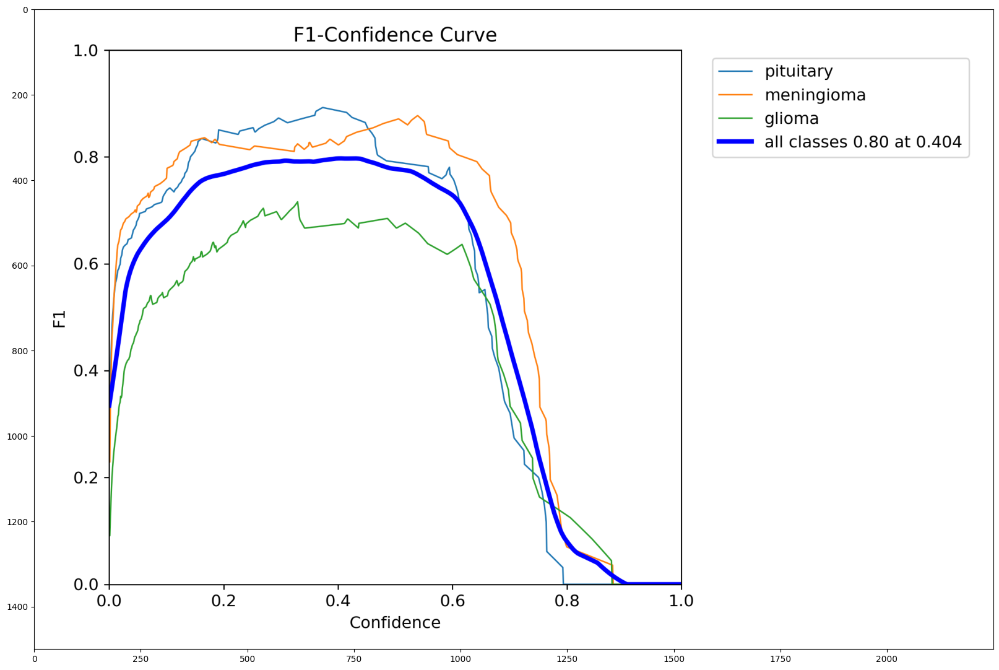

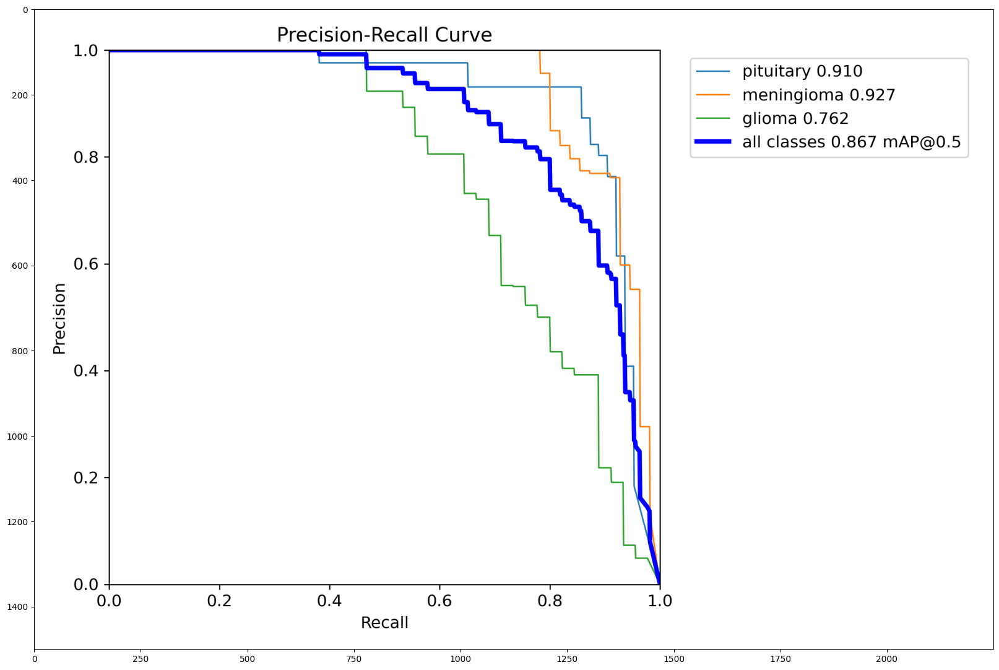

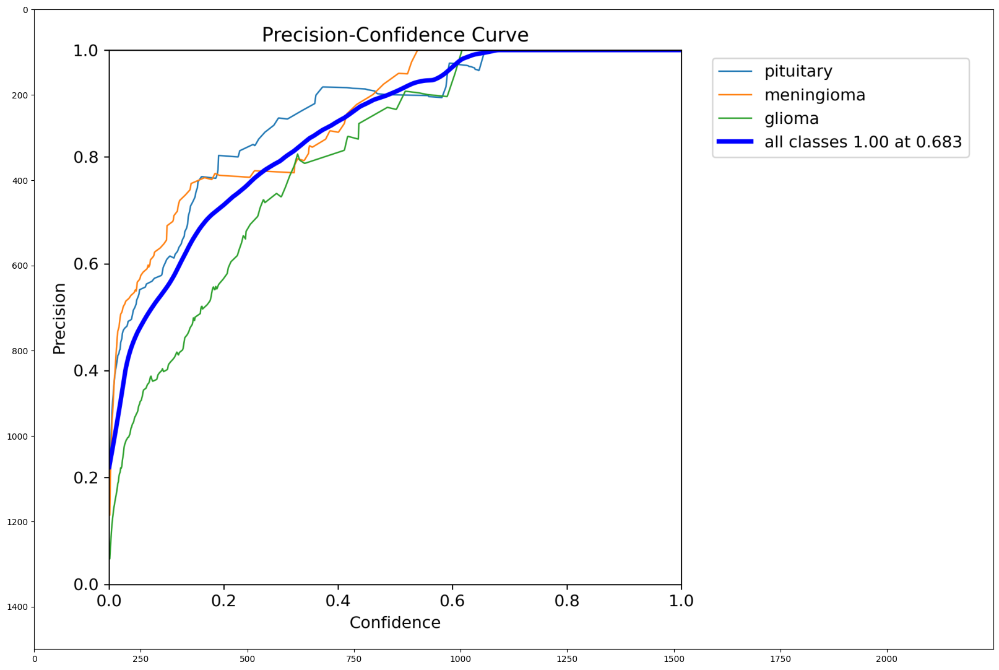

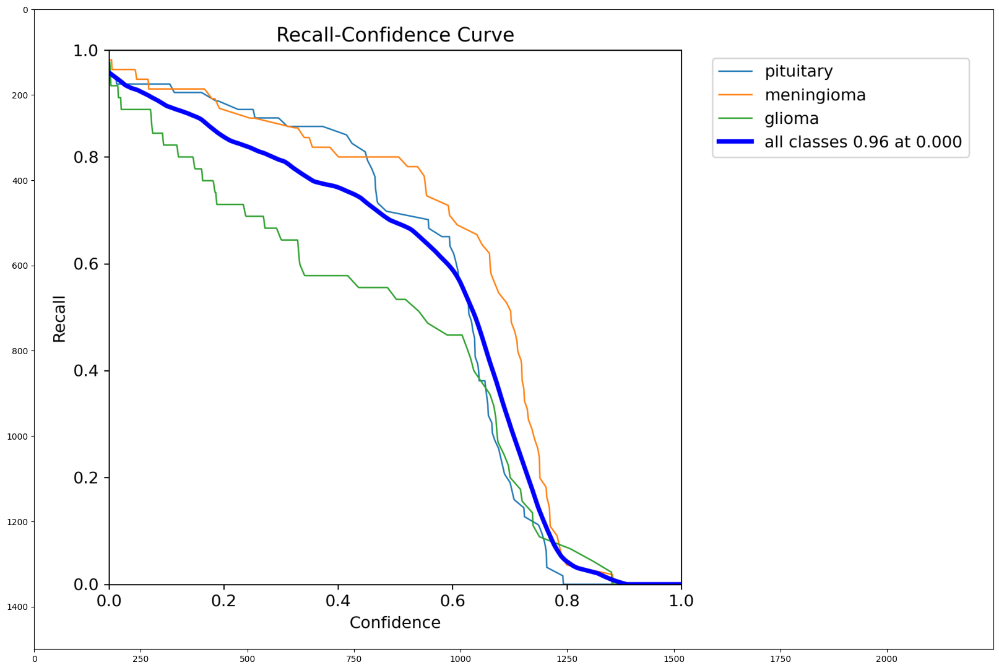

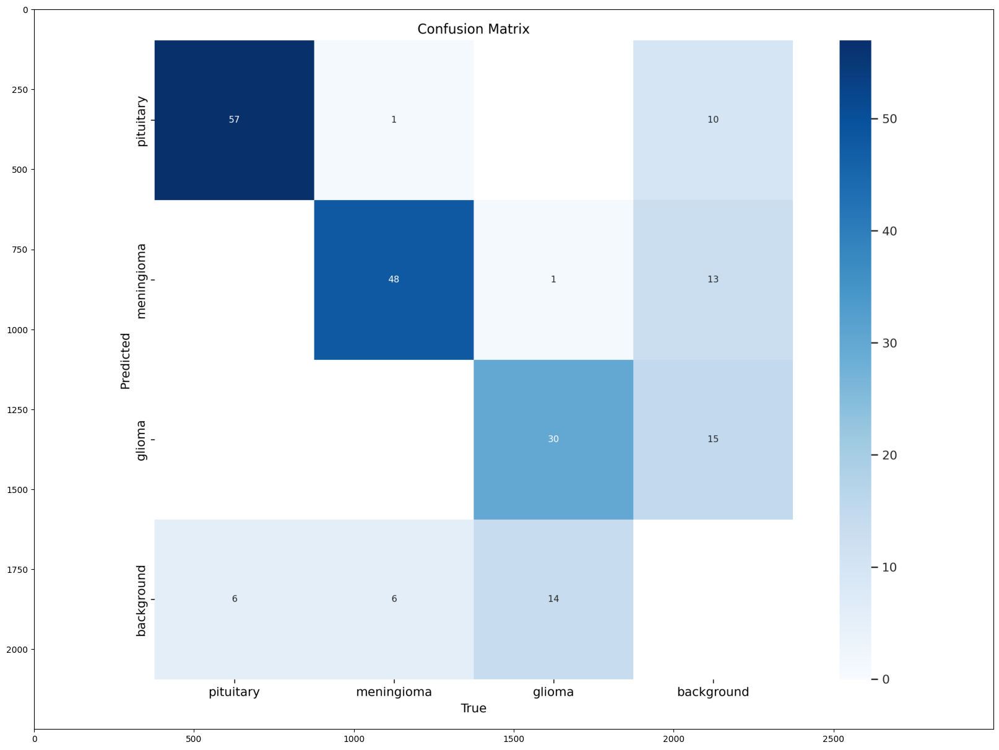

...

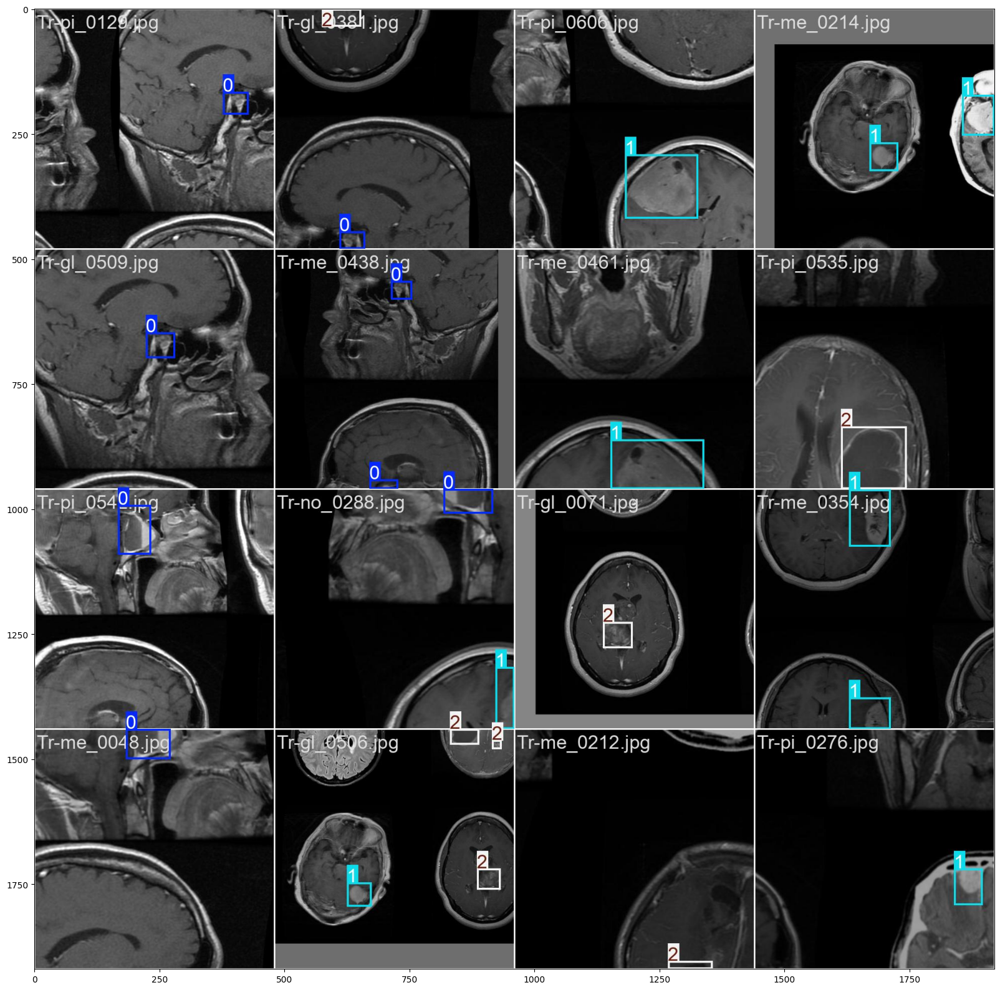

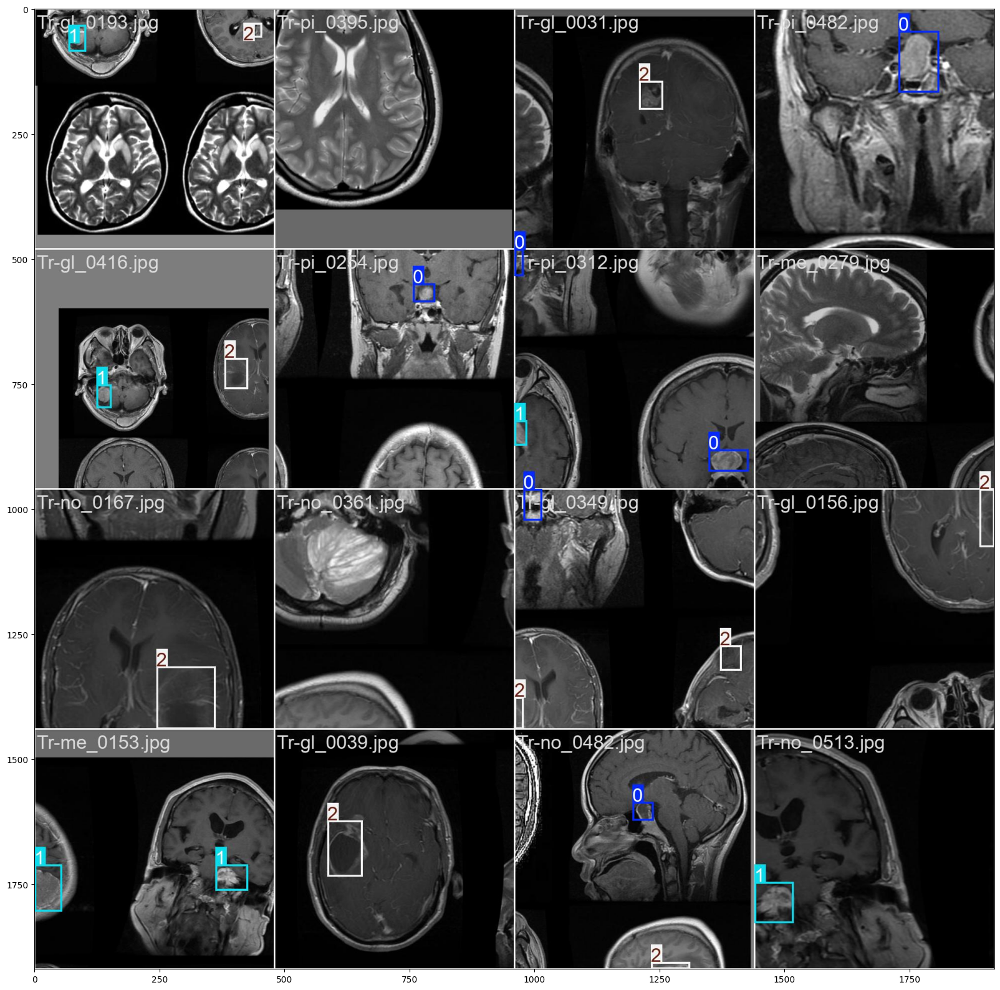

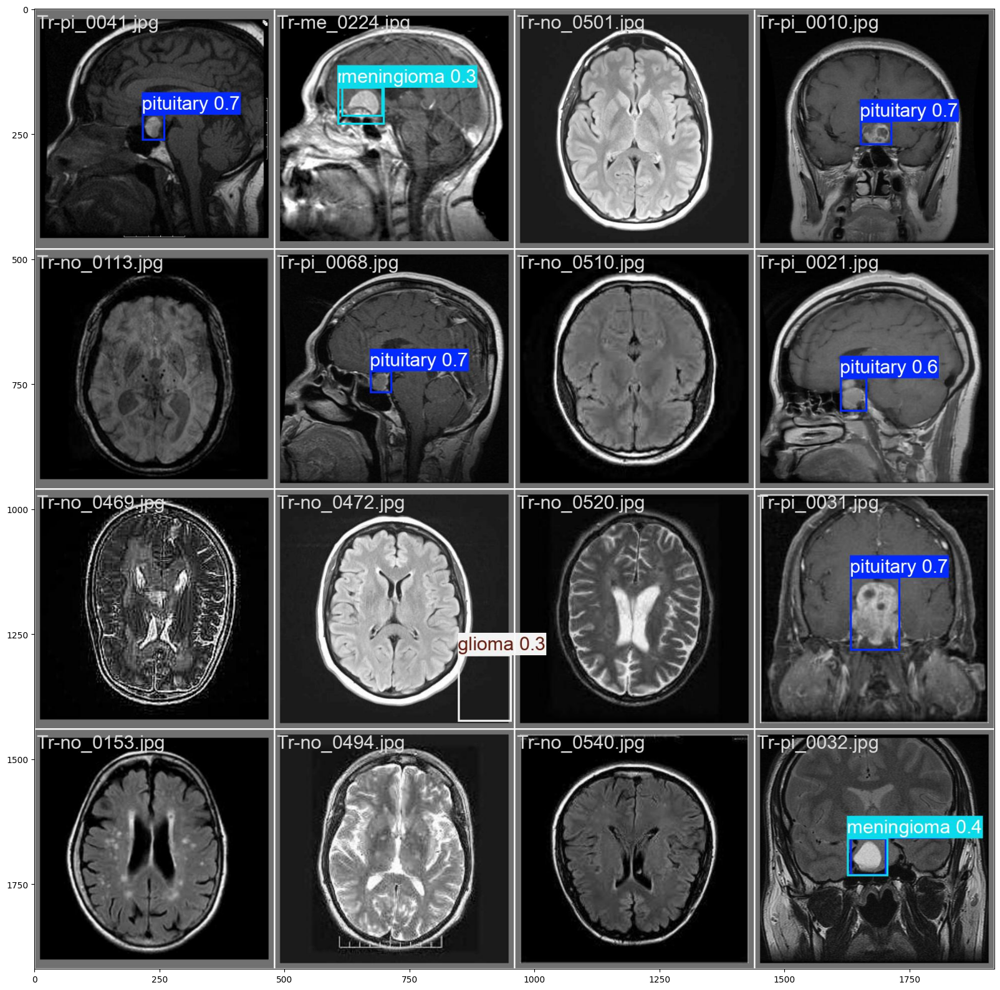

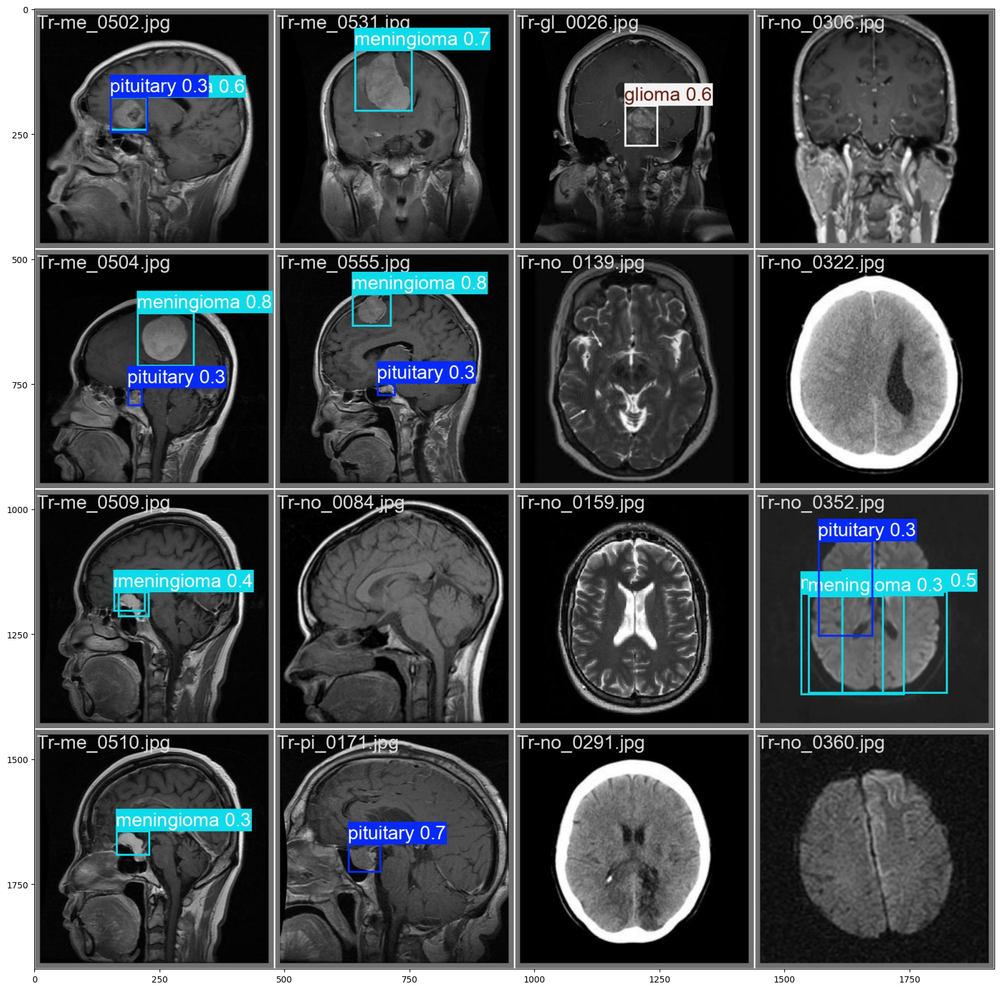

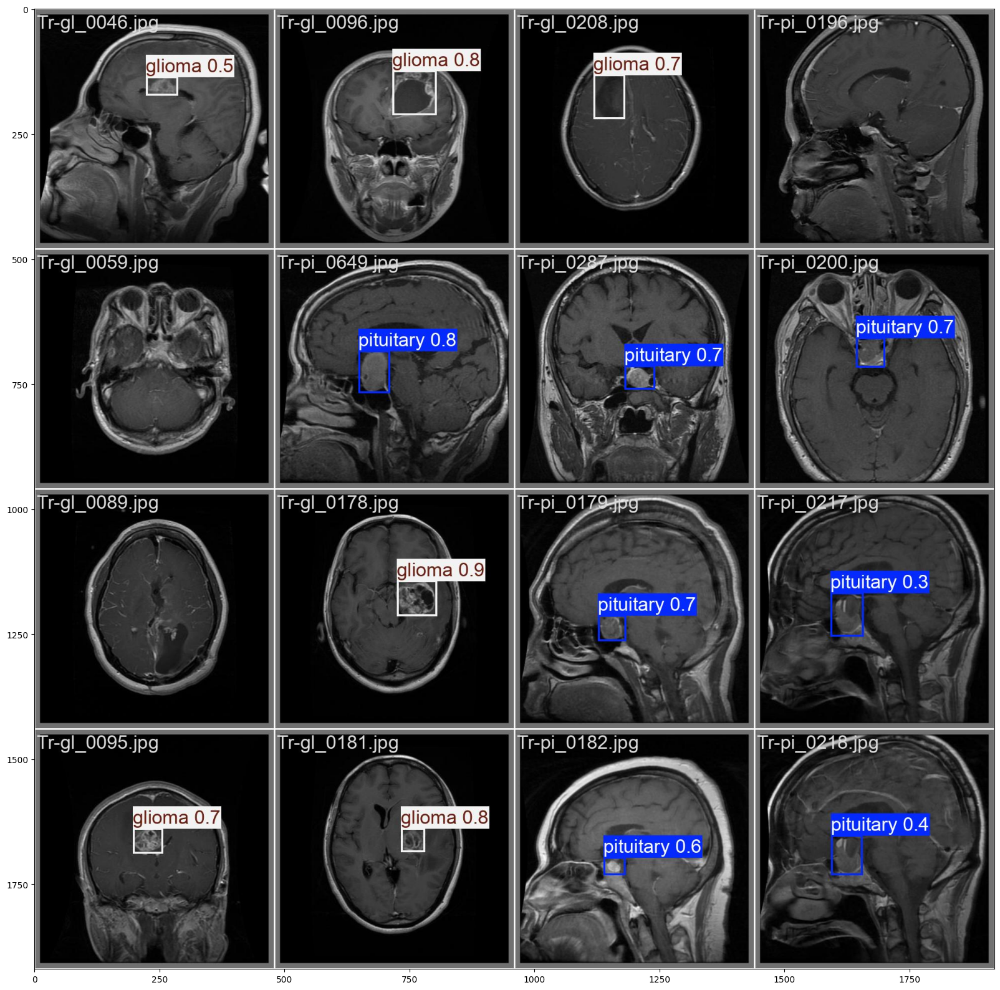

In [9]:
for path in sorted(glob.glob('/kaggle/working/runs/detect/train/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/runs/detect/train/*.jpg')):
    if not path.split('.')[0].endswith('_labels') or path.split('.')[0].startswith('train_'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()

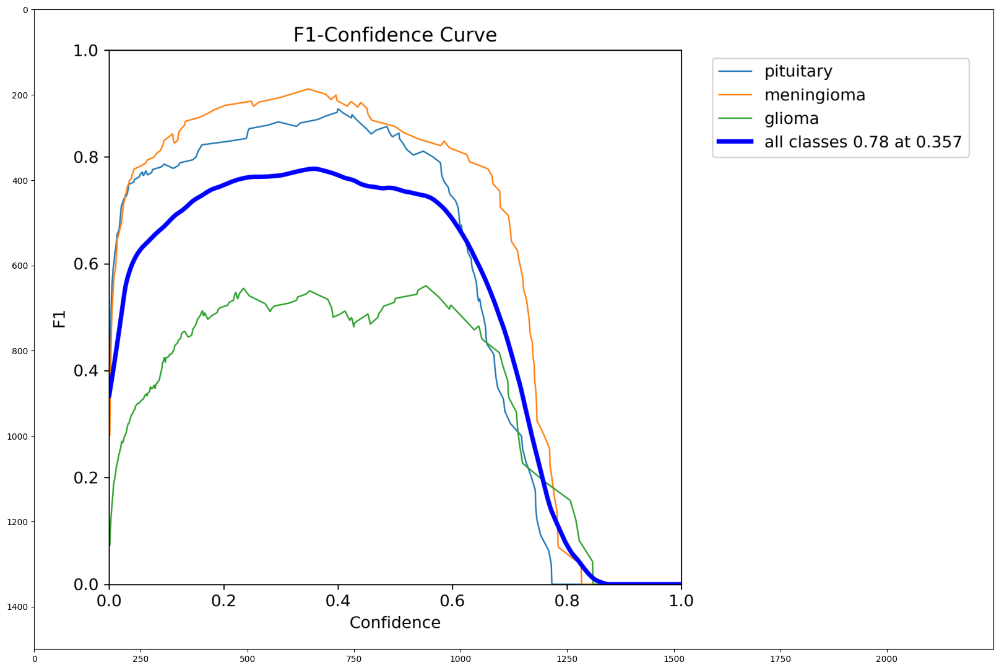

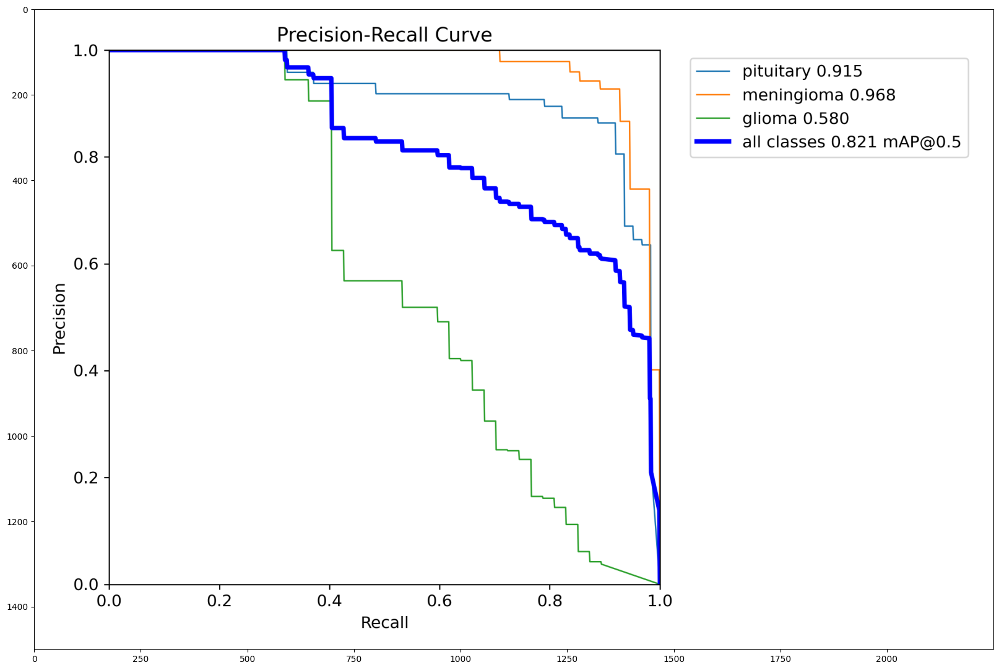

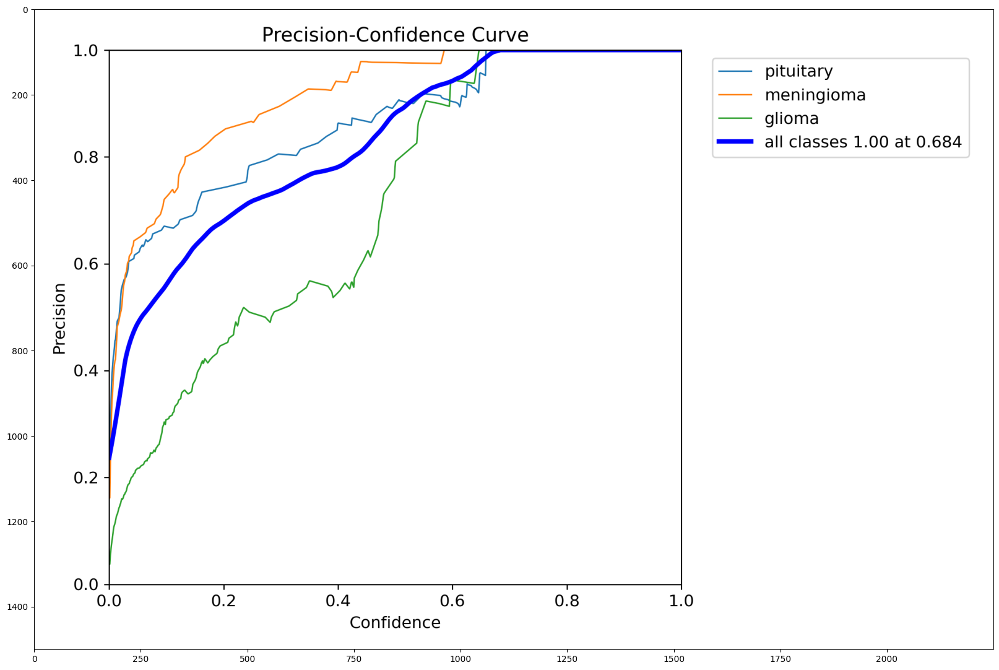

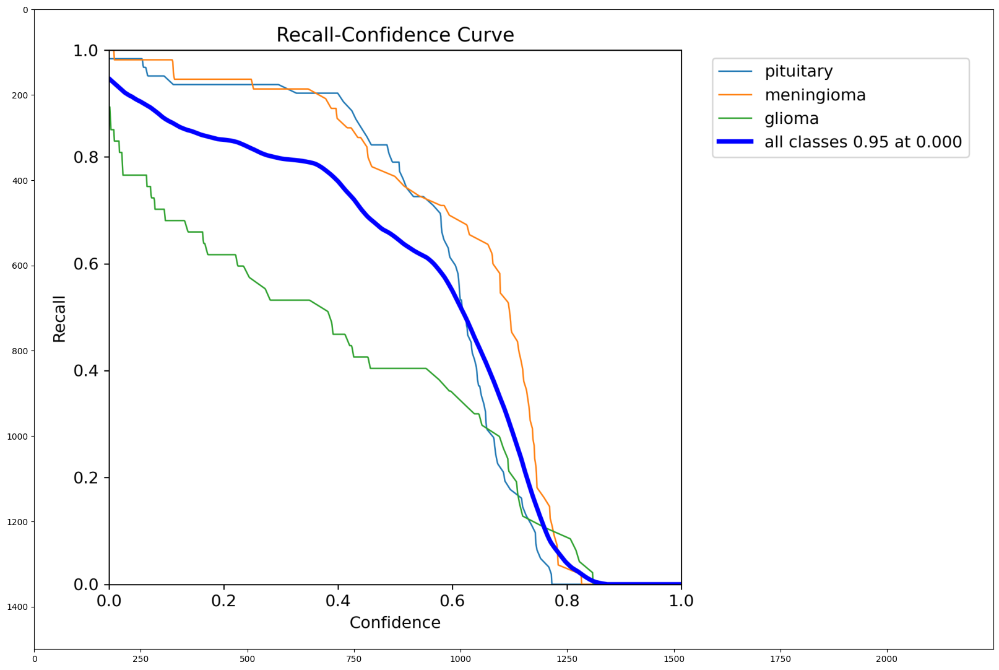

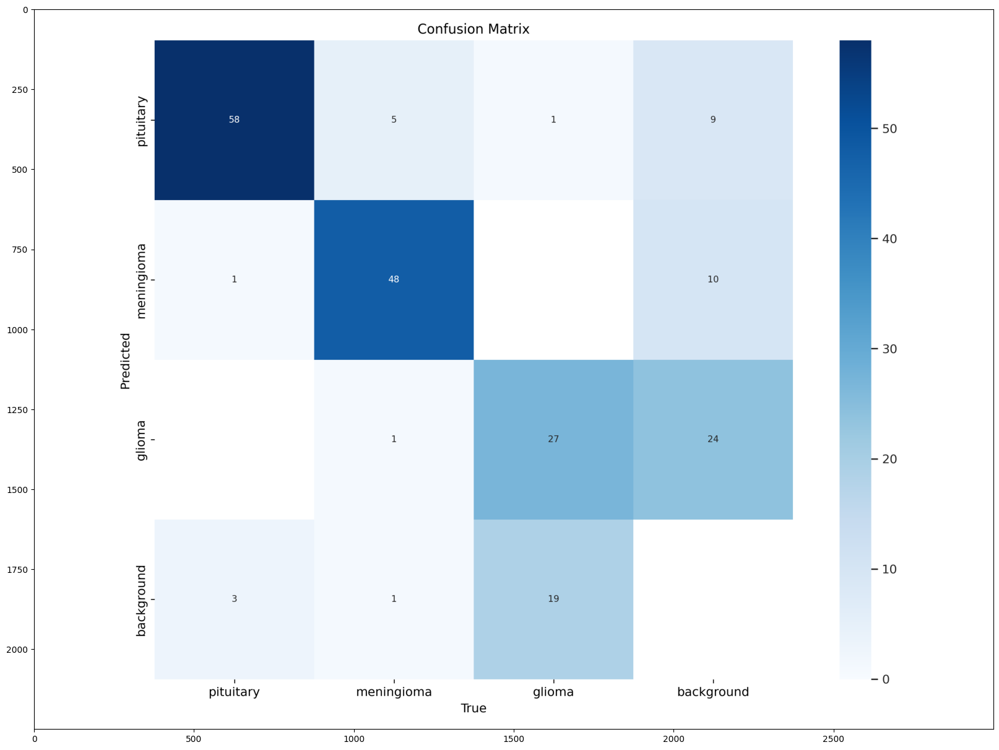

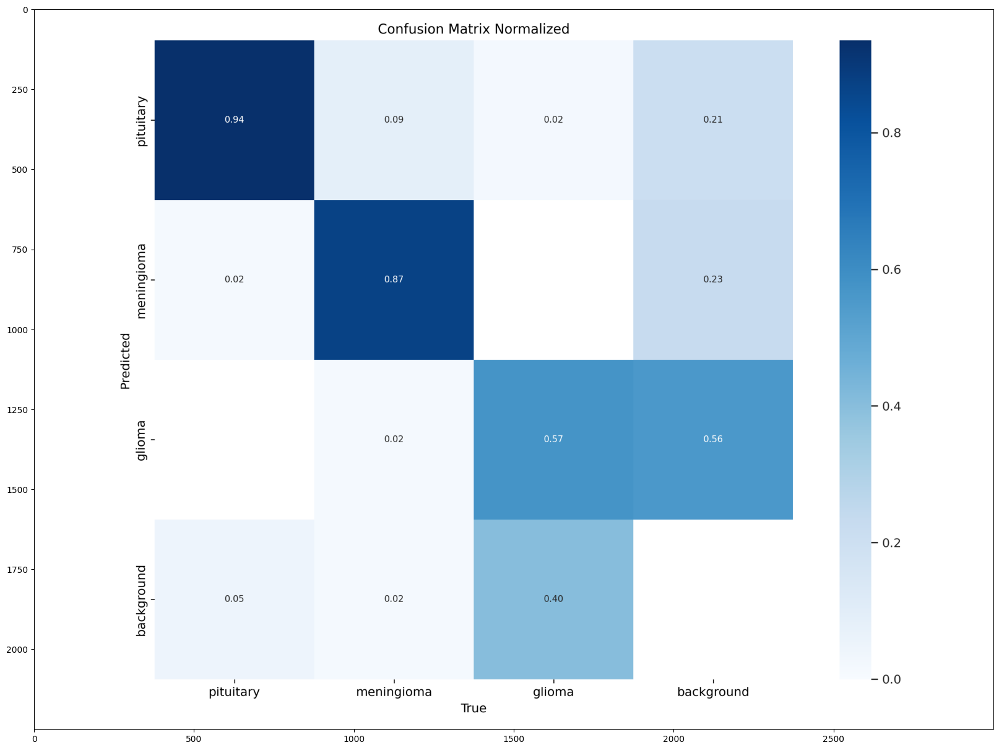

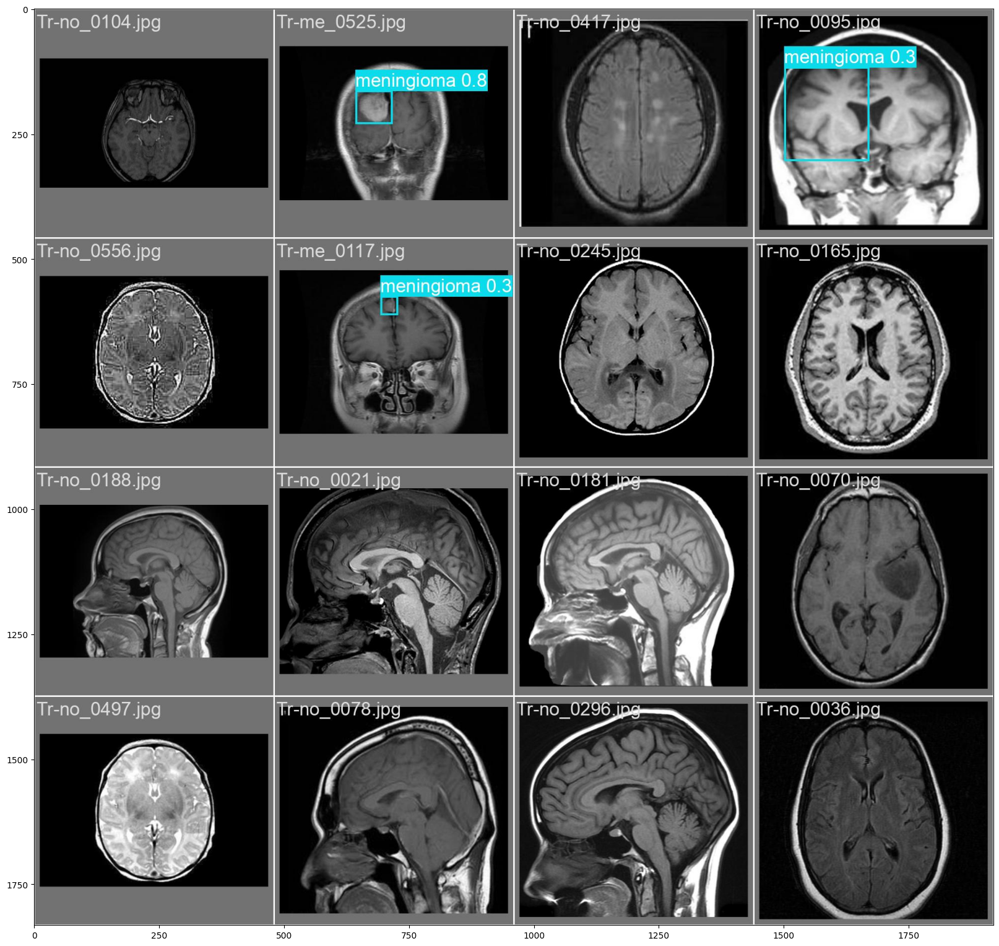

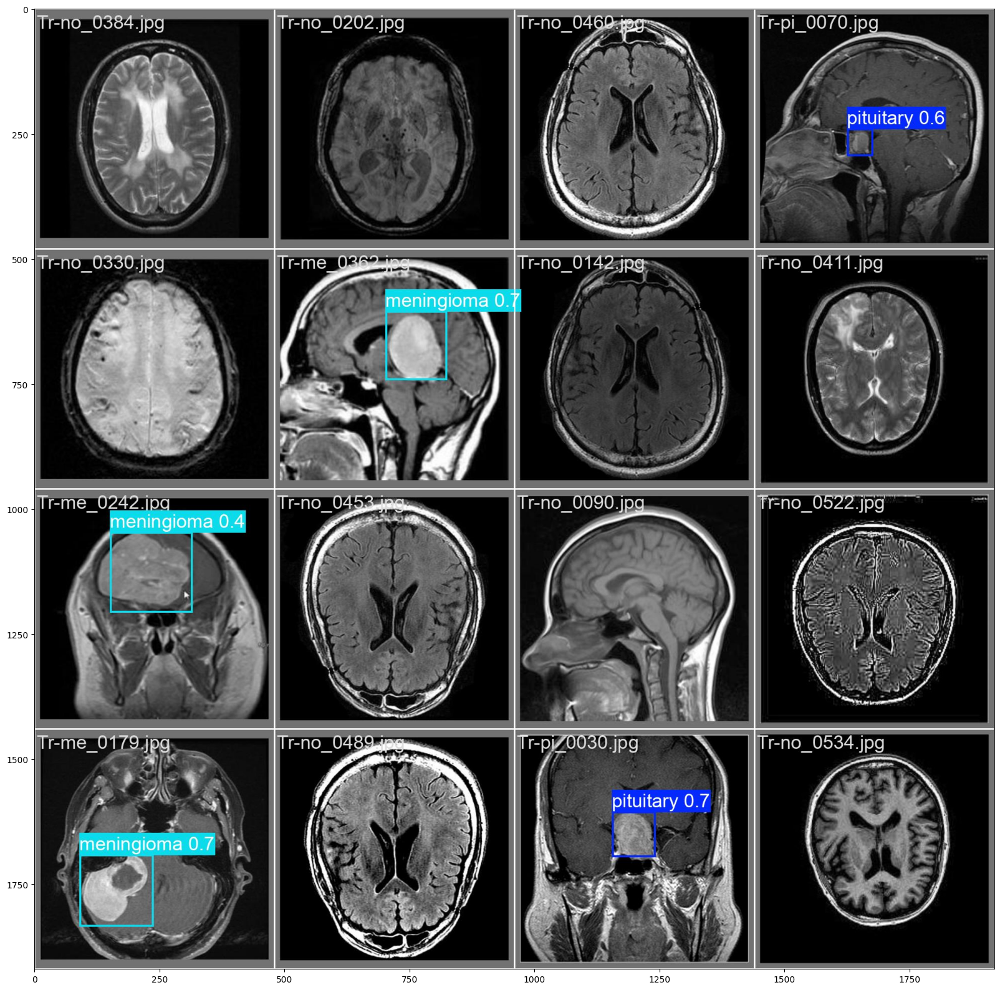

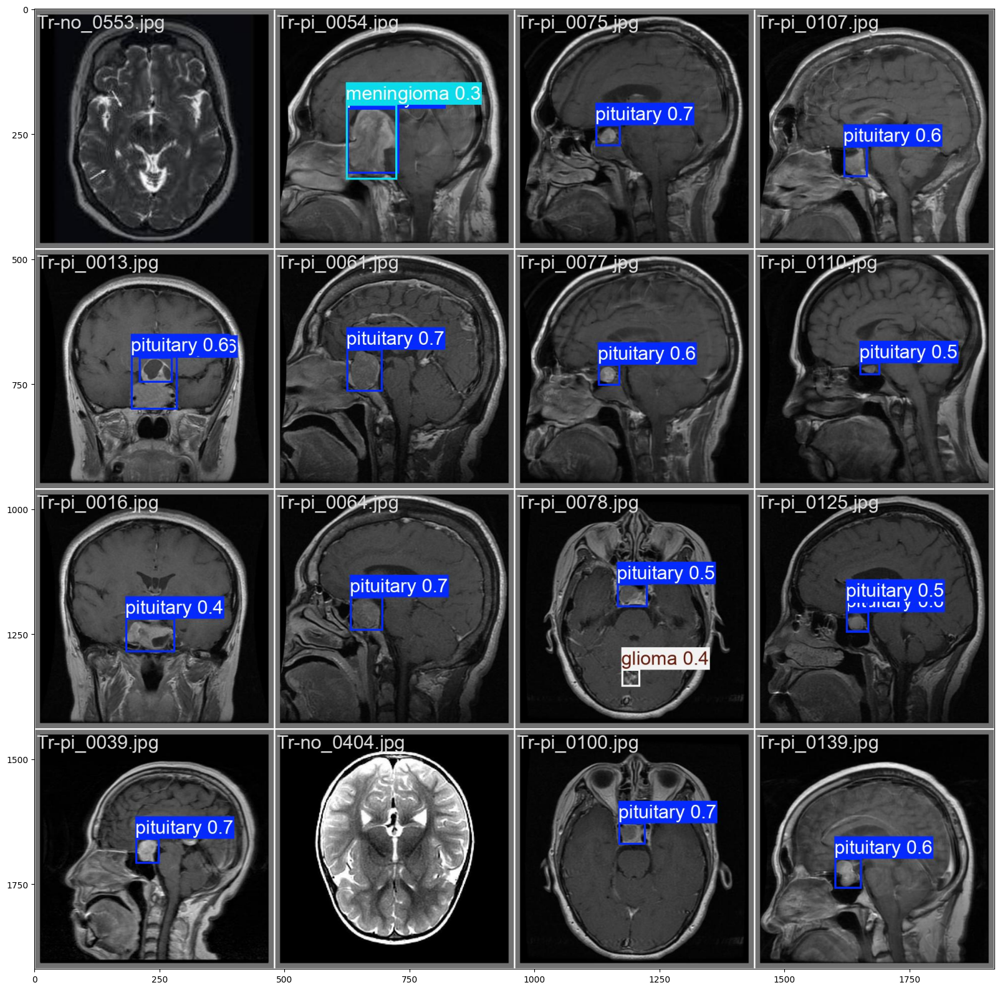

In [10]:
for path in sorted(glob.glob('/kaggle/working/runs/detect/train2/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/runs/detect/train2/*.jpg')):
    if not path.split('.')[0].endswith('_labels'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()